In [3]:
import pandas as pd
import jieba as jb
import re
from collections import Counter

In [4]:
df_ibm = pd.read_csv("ibm.csv", encoding="utf-8")
df_lx = pd.read_csv("lx.csv", encoding="utf-8")

In [5]:
# clean 
stop_words_baidu = pd.read_csv("~/GitProject/stopwords/baidu_stopwords.txt").iloc[:,0].tolist()
stop_words_scu = pd.read_csv("~/GitProject/stopwords/scu_stopwords.txt").iloc[:,0].tolist()
stop_words_cn = pd.read_csv("~/GitProject/stopwords/cn_stopwords.txt").iloc[:,0].tolist()
stop_words = stop_words_baidu+stop_words_scu+stop_words_cn
def clean(column:pd.Series)->pd.Series:
    # 删除空格
    column = column.str.replace(r'\s+', '', regex=True)
    # 删除标点符号
    column = column.apply(lambda x: re.sub(r'[^\u4e00-\u9fa5]','', x)) 
    # 删除英文
    column = column.apply(lambda x: re.sub(r'[a-zA-Z]', '', x))
    # 分词
    column = column.apply(lambda x: list(jb.cut(x)))
    # 删除停用词
    column = column.apply(lambda x:[word for word in x if word not in stop_words])
    return column

In [6]:
df_ibm['正文'] = clean(df_ibm['正文'])
df_lx['正文'] = clean(df_lx['正文'])

Building prefix dict from the default dictionary ...
Loading model from cache /var/folders/01/1174jc117vzf93t8k0kqhg9h0000gn/T/jieba.cache
Loading model cost 0.625 seconds.
Prefix dict has been built successfully.


In [7]:
print(df_ibm['正文'][0])

['月', '消息', '轰动', '中国', '科技界', '圈', '中国', '科研', '团队', '研发', '天机', '芯片', '登上', '自然', '杂志', '封面', '相关', '文章', '展示', '清华大学', '施路平', '团队', '研发', '世界', '首款', '异构', '融合', '类脑', '芯片', '支持', '脉冲', '神经网络', '支持', '人工', '神经', '网路', '公布', '利用', '天机', '芯片', '自行车', '自动', '驾驶', '实验', '视频', '这件', '事', '投资界', '产业界', '影响', '近', '段时间', '类脑', '芯片', '类脑', '计算', '相关', '投融资', '并购', '创业', '公司', '类脑', '相关', '会议', '活动', '增加', '说类', '脑热', '远远', '谈不上', '领域', '升温', '却是', '真实', '目光', '放得', '更', '远', '一点', '类脑', '芯片', '确实', '几年', '大规模', '爆发', '大学', '实验室', '科技', '巨头', '纷纷', '拿出', '类脑', '芯片', '产品', '专家学者', '人工智能', '经历', '简单', '人工智能', '深度', '人工智能', '通用', '人工智能', '三个', '阶段', '深度', '学习', '代表', '第二阶段', '类脑', '计算', '通用', '智能', '大门', '钥匙', '事已至此', '大众', '感觉', '类脑', '芯片', '注定', '未来', '人类', '找到', '通向', '强', '人工智能', '门径', '果真如此', '类脑', '芯片', '终极', '答案', '埋藏', '太', '不确定性', '想要', '客观', '类脑', '芯片', '未来', '时间', '倒', '回', '先', '理解', '一段', '人类', '神经', '大脑', '神经', '行为学', '之外', '一条', '路', '人类', '大脑', '智慧', '中', '抽取', '提炼', '某种', '技术',

In [8]:
all_words_ibm = [word for sublist in df_ibm['正文'] for word in sublist]
all_words_lx = [word for sublist in df_lx['正文'] for word in sublist]
word_freq_ibm = Counter(all_words_ibm)
word_freq_lx = Counter(all_words_lx)
# for word, freq in word_freq_ibm.most_common():
#     if(freq =50):
#         print(f"{word}: {freq}")

In [9]:
from sklearn.feature_extraction.text import CountVectorizer
from sklearn.decomposition import LatentDirichletAllocation
from sklearn.manifold import TSNE

In [10]:
text_ibm = df_ibm['正文'].astype(str)
text_lx = df_lx['正文'].astype(str)

In [11]:
# 创建文档-词项矩阵并转换为系数矩阵
vertorizer_ibm = CountVectorizer()
vertorizer_lx = CountVectorizer()
X_ibm = vertorizer_ibm.fit_transform(text_ibm)
X_lx = vertorizer_lx.fit_transform(text_lx)

In [12]:
# 查看文档-词项矩阵
dense_matrix_ibm = X_ibm.toarray()
dense_matrix_lx = X_lx.toarray()
feature_names_ibm = vertorizer_ibm.get_feature_names_out()
feature_names_lx = vertorizer_lx.get_feature_names_out()
word_matrix_ibm = pd.DataFrame(dense_matrix_ibm,columns=feature_names_ibm)
word_matrix_lx = pd.DataFrame(dense_matrix_lx, columns=feature_names_lx)
print("IBM文档词项矩阵\n", word_matrix_ibm)
print("灵汐科技文档词项矩阵\n", word_matrix_ibm)

IBM文档词项矩阵
      一一  一一对应  一万  一万个  一万亿  一万年  一丘之貉  一丝  一两个  一两年  ...  鼎盛时期  鼓励  鼓掌  鼓舞人心  \
0     0     0   0    0    0    0     0   0    0    0  ...     0   0   0     0   
1     0     0   0    0    0    0     0   0    0    0  ...     0   0   0     0   
2     0     0   0    0    0    0     0   0    0    0  ...     0   0   0     0   
3     0     1   0    0    0    0     0   0    0    0  ...     0   0   0     0   
4     0     0   0    0    0    0     0   0    0    0  ...     0   0   0     0   
..   ..   ...  ..  ...  ...  ...   ...  ..  ...  ...  ...   ...  ..  ..   ...   
96    0     0   0    0    0    0     0   0    0    0  ...     0   0   0     0   
97    0     0   0    0    0    0     0   0    0    0  ...     0   0   0     0   
98    0     0   0    0    0    0     0   0    0    0  ...     0   0   0     0   
99    0     0   0    0    0    0     0   0    0    0  ...     0   0   0     0   
100   0     0   0    0    0    0     0   0    0    0  ...     0   0   0     0   

     鼻子  鼻音  齐心合

In [13]:
# 训练LDA模型
lda_ibm = LatentDirichletAllocation(n_components=8, random_state=42)
lda_ibm.fit(X_ibm)

LatentDirichletAllocation(n_components=8, random_state=42)

In [14]:
lda_lx = LatentDirichletAllocation(n_components=8, random_state=42)
lda_lx.fit(X_lx)

LatentDirichletAllocation(n_components=8, random_state=42)

In [15]:
# 查看主题分布
topic_dist_ibm = lda_ibm.transform(X_ibm)
print("IBM文本主题分布\n", topic_dist_ibm,"\nIBM文本提取的主题的分布\n", lda_ibm.components_)

IBM文本主题分布
 [[1.26169186e-04 1.26073835e-04 1.26176293e-04 1.26129148e-04
  3.94562776e-01 1.26150165e-04 1.26104212e-04 6.04680421e-01]
 [1.93411648e-01 1.14287648e-04 1.14322069e-04 1.14295347e-04
  6.14955383e-01 1.14305635e-04 6.58332262e-03 1.84592437e-01]
 [2.34017139e-04 2.33777922e-04 2.33920539e-04 2.33808739e-04
  2.34146871e-04 2.33920869e-04 2.33760863e-04 9.98362647e-01]
 [5.51947549e-05 5.51735377e-05 5.52243143e-05 5.52140442e-05
  6.46585357e-02 5.52341272e-05 5.79422142e-01 3.55643281e-01]
 [1.53697026e-04 1.53684747e-04 1.53774146e-04 1.53713679e-04
  1.53808724e-04 1.53773931e-04 5.10903452e-01 4.88174096e-01]
 [9.59916976e-05 9.59267750e-05 9.59902969e-05 9.59374112e-05
  9.69652425e-01 9.59832230e-05 9.59517500e-05 2.97717941e-02]
 [2.06905107e-04 2.06784336e-04 2.06952865e-04 2.06828921e-04
  8.04369393e-01 3.17572488e-02 2.06837838e-04 1.62839049e-01]
 [1.69942361e-04 1.69962989e-04 1.70014839e-04 1.70060946e-04
  1.70014427e-04 1.70035848e-04 1.70046173e-04 9.988

In [16]:
topic_dist_lx = lda_lx.transform(X_lx)
print("灵汐科技文本主题分布\n", topic_dist_lx,"\n灵汐科技文本提取的主题的分布\n", lda_lx.components_)

灵汐科技文本主题分布
 [[6.08875358e-01 5.02653450e-04 5.02879652e-04 5.02652538e-04
  5.02310294e-04 3.13191983e-01 5.02663957e-04 7.54194992e-02]
 [1.14295670e-04 1.14298656e-04 1.14349889e-04 3.02069842e-02
  1.14746826e-04 9.69106625e-01 1.14329444e-04 1.14369976e-04]
 [8.77937157e-01 2.17324052e-04 2.17375738e-04 2.17292966e-04
  3.12424585e-02 8.97336902e-02 2.17283358e-04 2.17418207e-04]
 [4.27624747e-04 4.27301284e-04 4.27202914e-04 4.27269794e-04
  9.36540431e-02 8.47177872e-01 5.70312242e-02 4.27461917e-04]
 [3.81410222e-04 3.81551024e-04 3.82101774e-04 3.81318304e-04
  3.54203829e-03 9.76823671e-01 3.81314172e-04 1.77265956e-02]
 [1.22474432e-04 1.22463373e-04 7.79394709e-02 1.05081468e-02
  3.64842938e-03 8.96138189e-01 1.13983055e-02 1.22520735e-04]
 [1.49312564e-01 5.06879005e-04 5.06894445e-04 5.06779046e-04
  5.06478730e-04 8.47646523e-01 5.06781612e-04 5.07100245e-04]
 [2.06751890e-04 2.06891017e-04 2.13598539e-01 2.06848068e-04
  2.06826222e-04 7.85160283e-01 2.06840869e-04 2.07

In [17]:
import matplotlib.pyplot as plt
import numpy as np
import warnings
warnings.filterwarnings("ignore")

In [33]:
def DrawDist(topic_dist, com):
    plt.figure()
    plt.hist(np.argmax(topic_dist, axis=1), bins =5, edgecolor = 'black')
    plt.title(f'The Distribution of {com} Text Toppic')
    plt.xlabel('Topic')
    plt.ylabel('Frequency')
    plt.show()

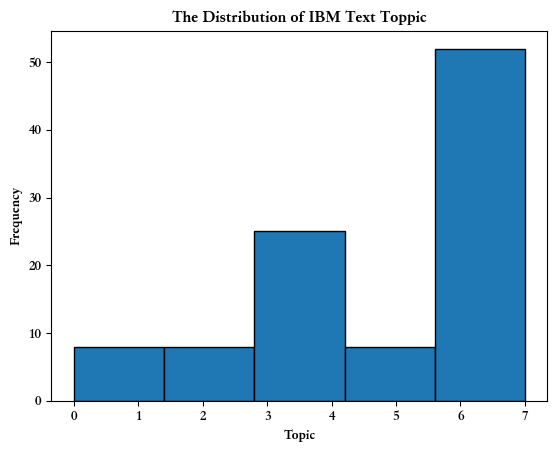

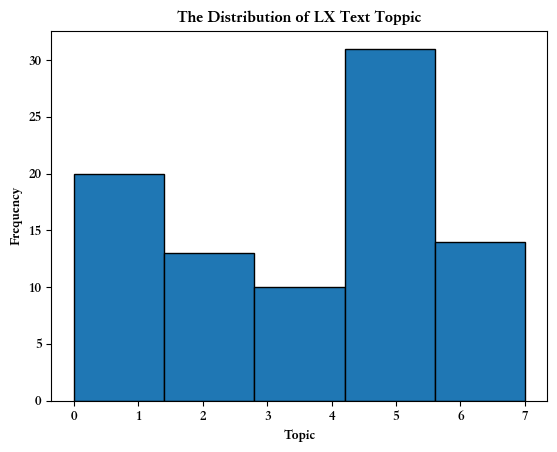

In [34]:
DrawDist(topic_dist_ibm, 'IBM')
DrawDist(topic_dist_lx, 'LX')

In [20]:
# 提取主题关键词
n_top_words = 10
def PrintTopicKeywords(com, lda_model:LatentDirichletAllocation, feature_names):
    print(f'{com}主题关键词:')
    for topic_index, topic in enumerate(lda_model.components_):
        print(f'Topic #{topic_index}:')
        topic_words_index = topic.argsort()[-n_top_words:][::-1]
        print(" ".join(feature_names[topic_words_index]))

In [21]:
PrintTopicKeywords('IBM', lda_ibm, feature_names_ibm)

IBM主题关键词:
Topic #0:
项目 工作 时间 代码 演讲 本周 语言 网站 会议 告诉
Topic #1:
处理器 神经网络 数据 学习 技术 视频 人工智能 手机 深度 星光
Topic #2:
数据 学习 搜索 模型 科学 工作 公司 提供 机器 技术
Topic #3:
测试 器件 华为 硬件 工程师 内存 设计 产品 公司 分析
Topic #4:
类脑 计算 研究 智能 神经元 模型 学习 大脑 神经网络 神经
Topic #5:
数据 学习 科学 模型 机器 科学家 分析 课程 工作 领域
Topic #6:
博客 领域 博主 算法 计算 学习 深度 技术 投资 组合
Topic #7:
芯片 计算 架构 处理器 设计 神经元 数据 苏联 性能 技术


In [22]:
PrintTopicKeywords('灵汐科技',lda_lx,feature_names_lx)

灵汐科技主题关键词:
Topic #0:
互联网 科技 世界 科技成果 领先 发布 领域 全球 计算 技术
Topic #1:
芯片 计算 科技 类脑 技术 神经 开源 脉冲 人脑 社区
Topic #2:
类脑 计算 系统 研究 芯片 完备 感知 团队 视觉 计算机
Topic #3:
报告 人工智能 中国 白皮书 研究 生成式 行业 发展 产业 模型
Topic #4:
有限公司 科技 微电子 上海 北京 设计 半导体 技术 电子科技 深圳市
Topic #5:
芯片 计算 类脑 模型 智能 研究 神经元 神经网络 支持 发展
Topic #6:
报告 人工智能 中国 白皮书 技术 合集 发展 专题 分享 研究
Topic #7:
芯片 人工智能 计算 学习 算法 深度 技术 公司 处理器 发展


In [23]:
# 生成词云
from wordcloud import  WordCloud

In [24]:
def DrawWordCloud(lda_model:LatentDirichletAllocation, feature_names):
    for topic_index, topic in enumerate(lda_model.components_):
        plt.figure(dpi = 300)
        wordcloud = WordCloud(font_path='/System/Library/Fonts/Supplemental/Songti.ttc',
                            background_color = 'white',
                            width = 800,
                            height = 400).generate_from_frequencies(
                                {feature_names[i]: topic[i] for i in range(len(topic))}
                            )
        plt.imshow(wordcloud, interpolation='bilinear')
        plt.title(f"Word Cloud for Topic #{topic_index}")
        plt.axis('off')
        plt.show()

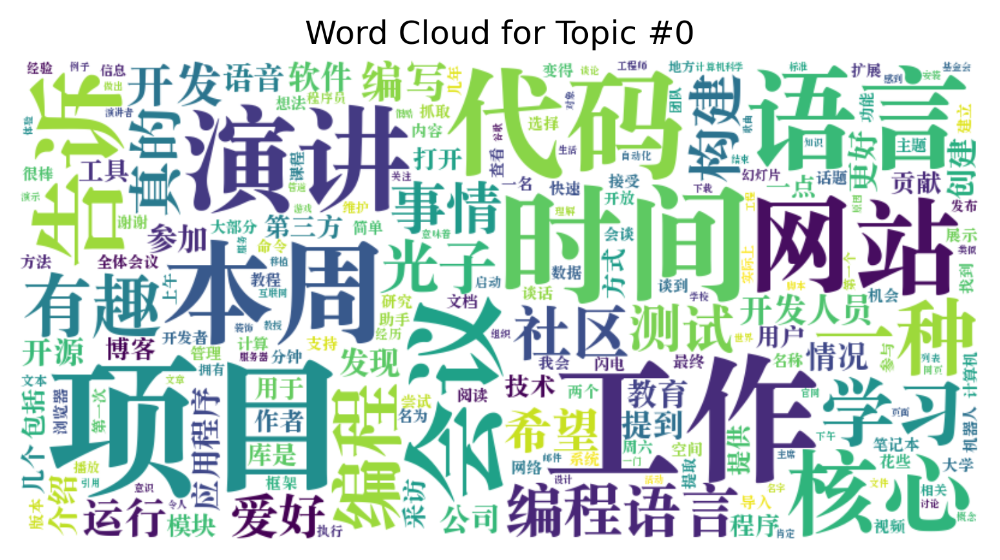

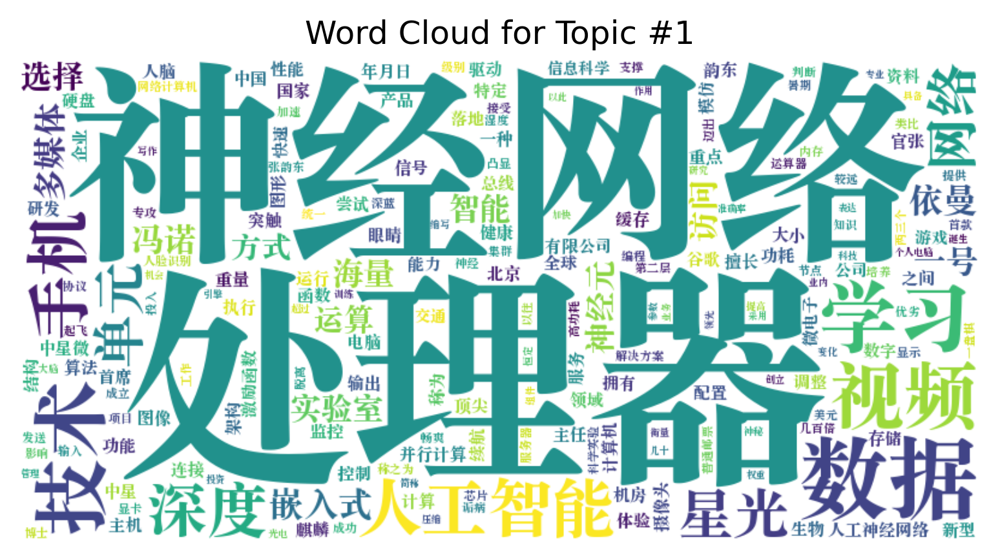

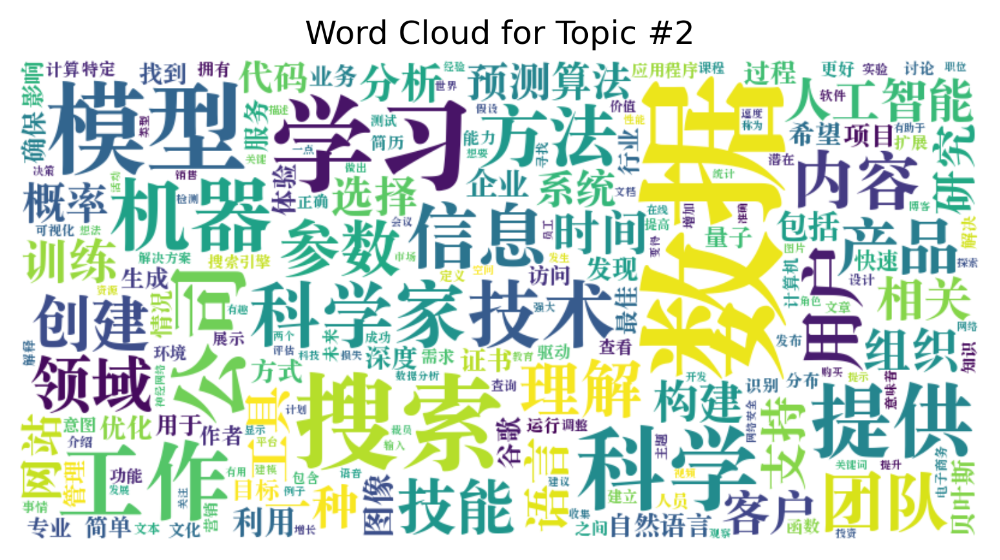

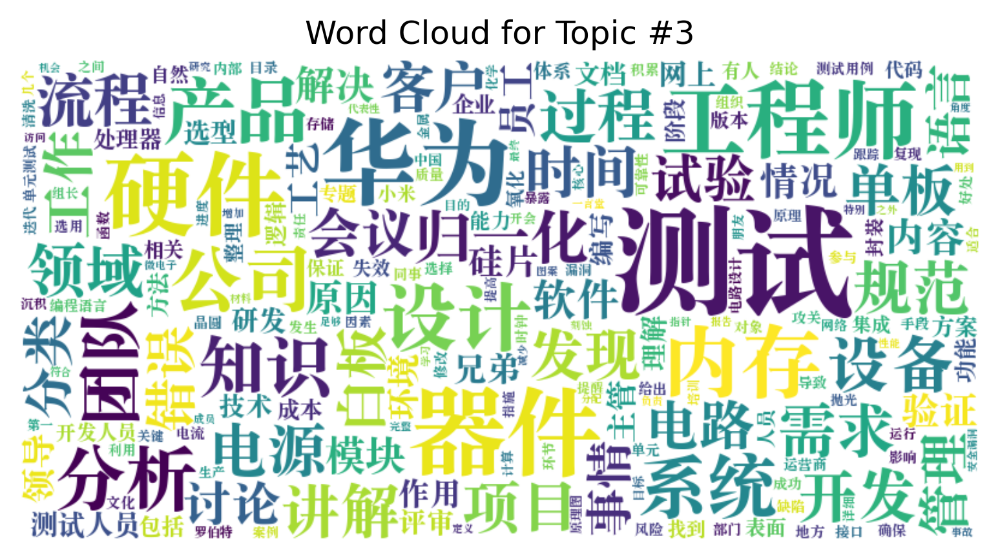

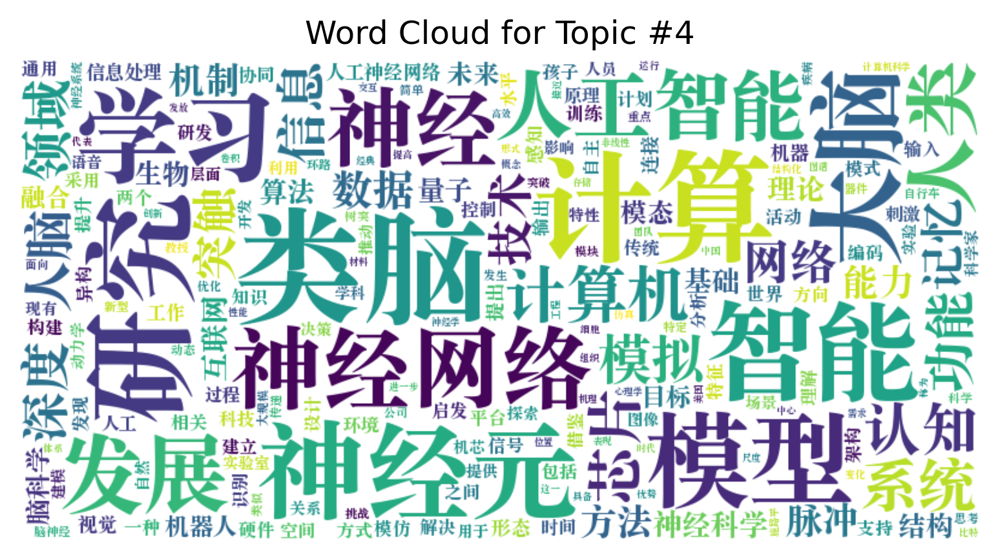

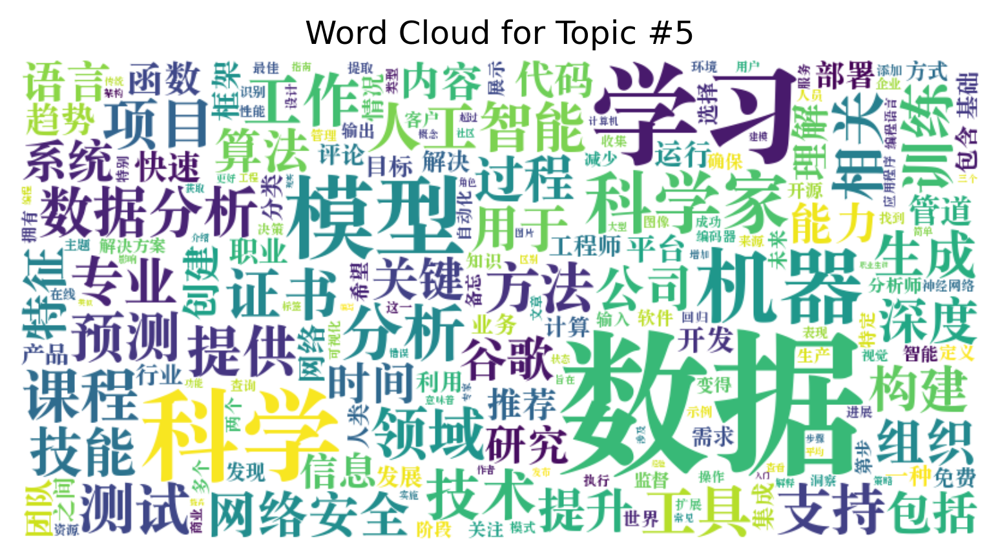

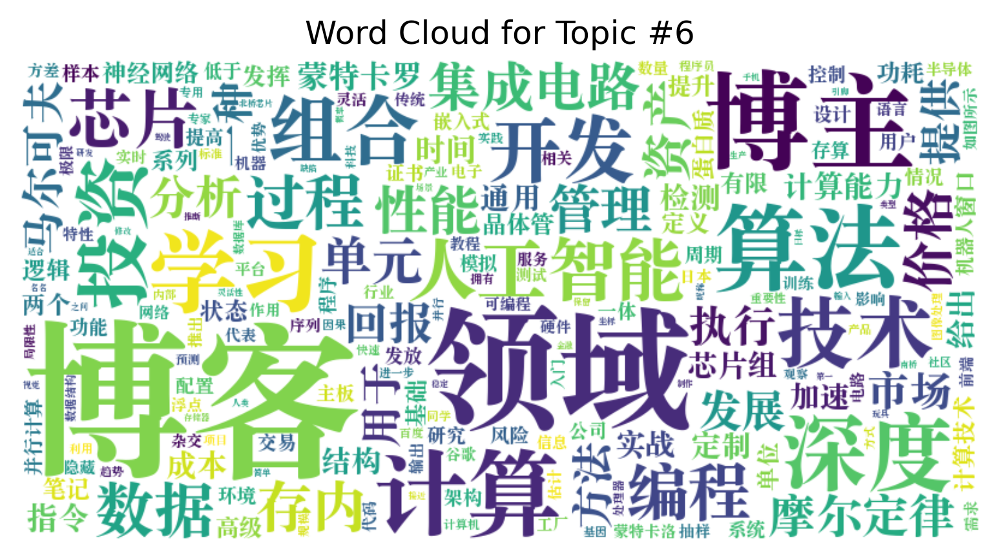

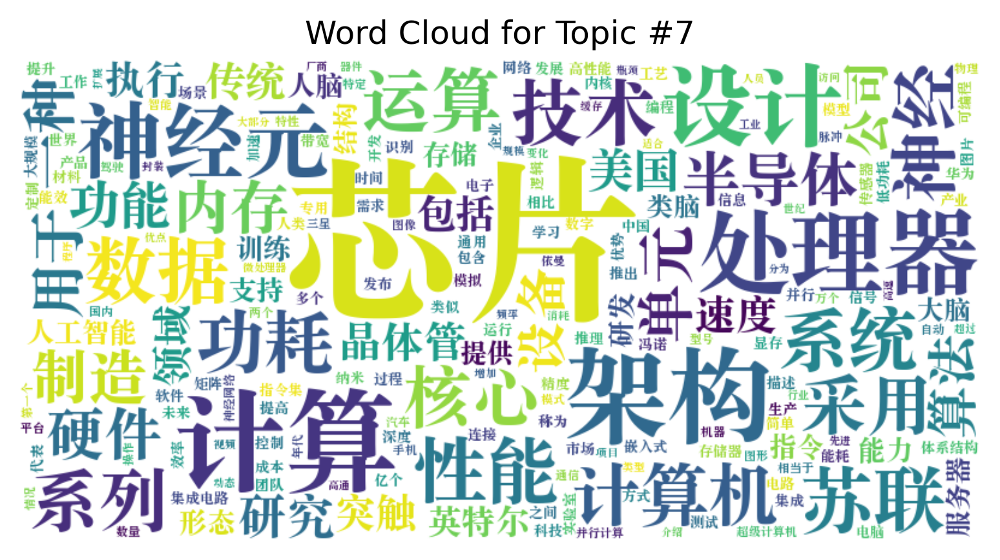

In [25]:
DrawWordCloud(lda_ibm,feature_names_ibm)

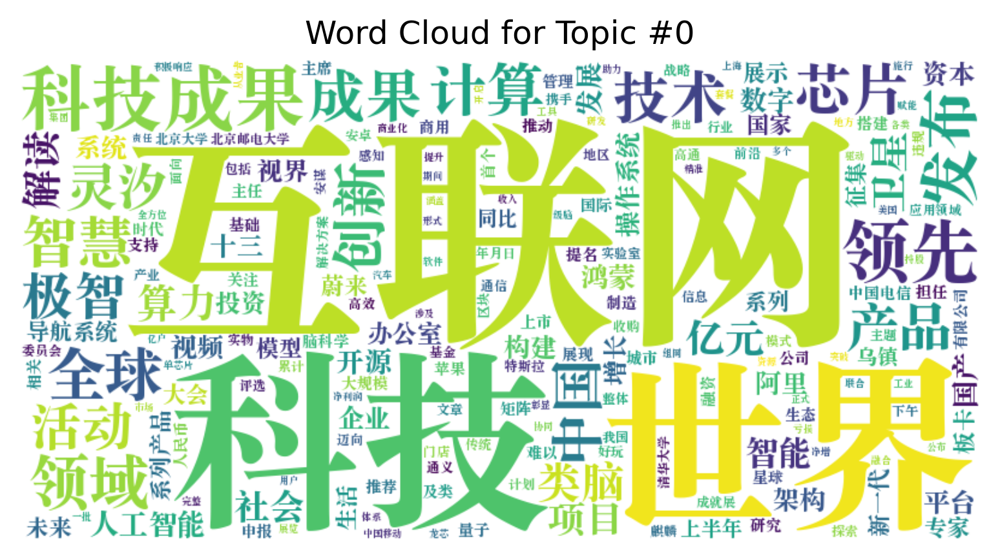

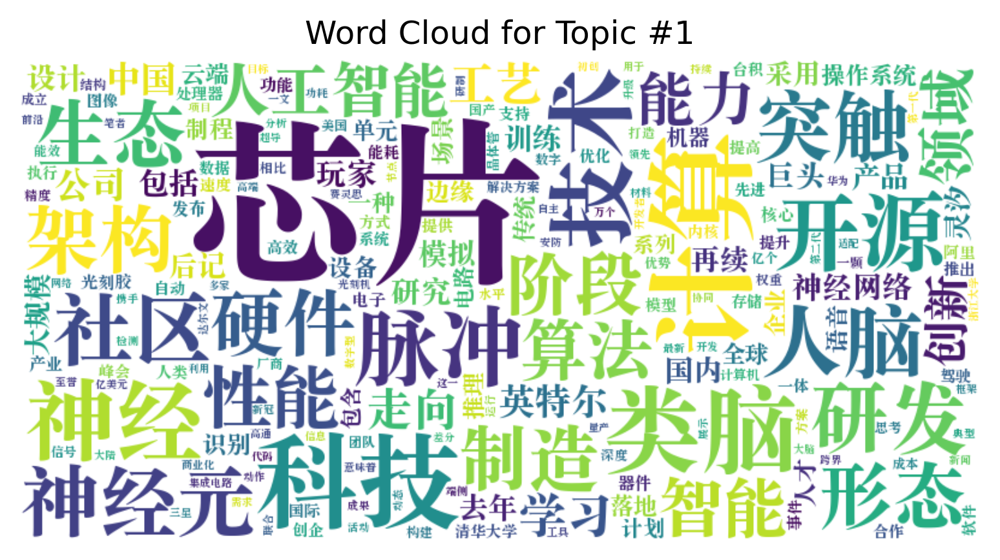

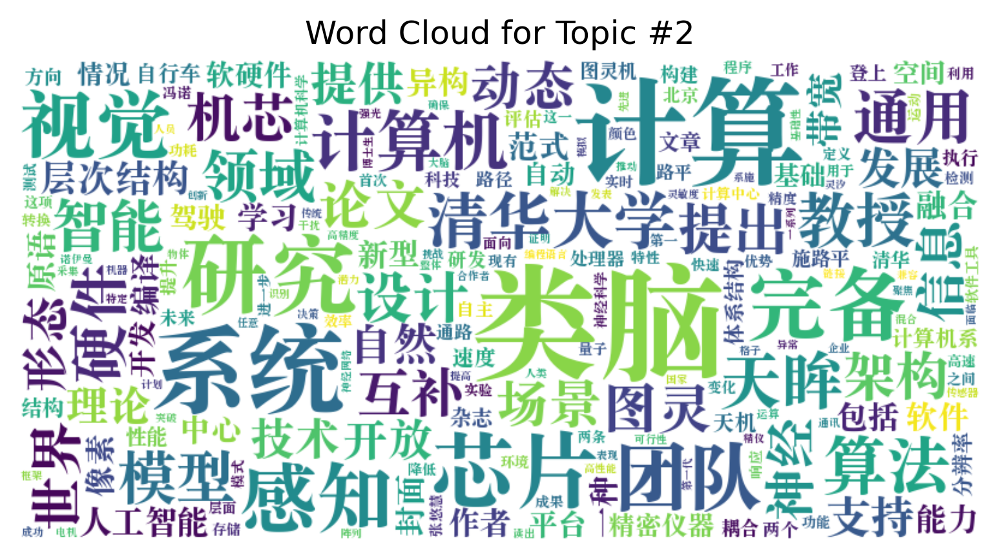

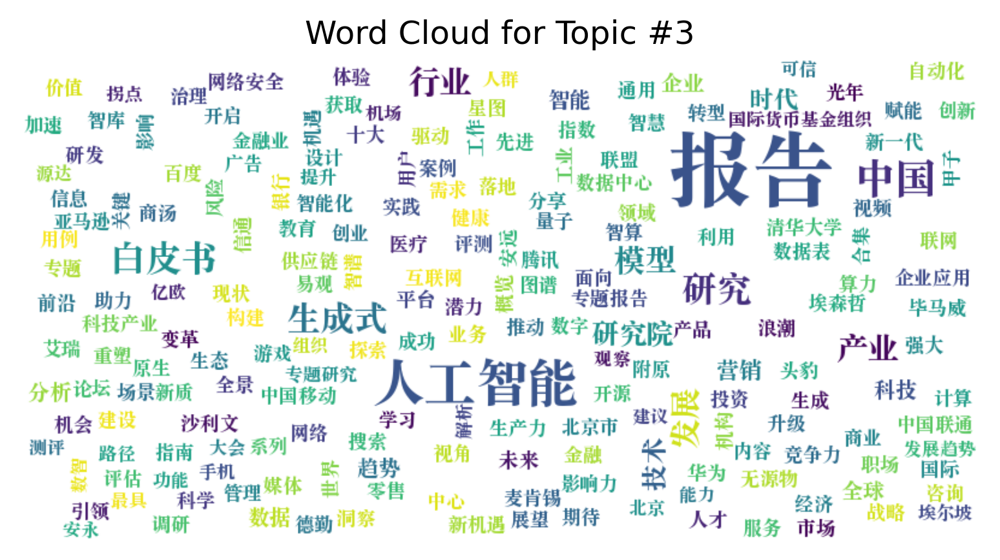

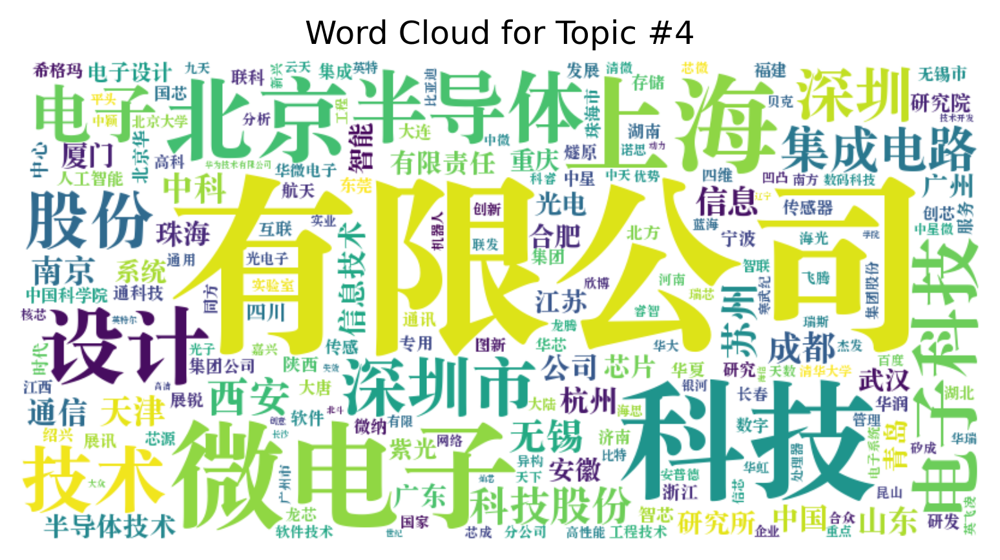

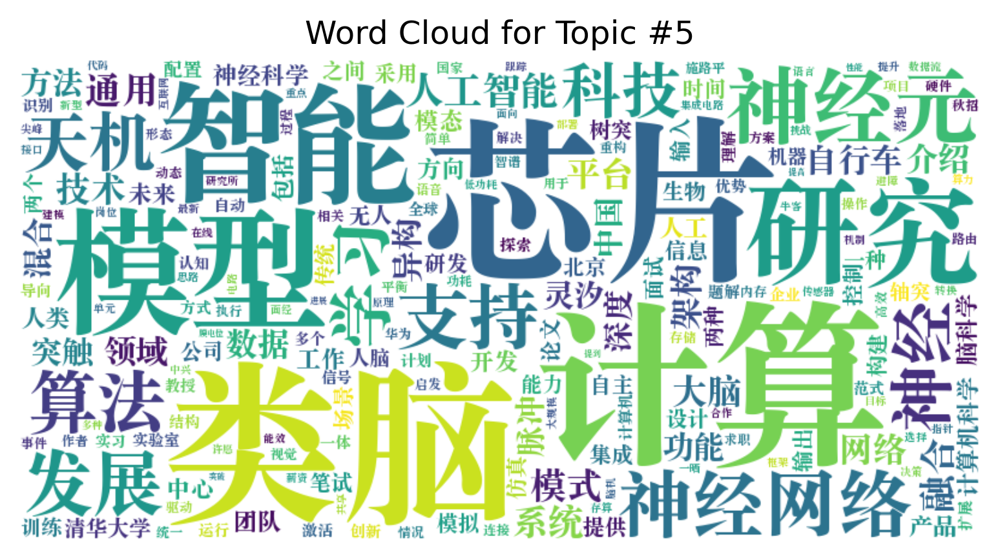

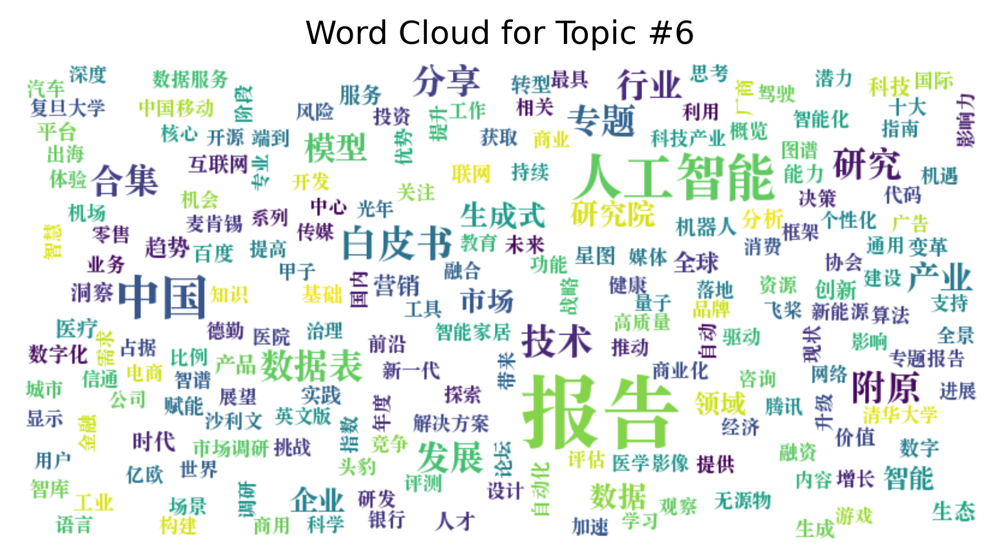

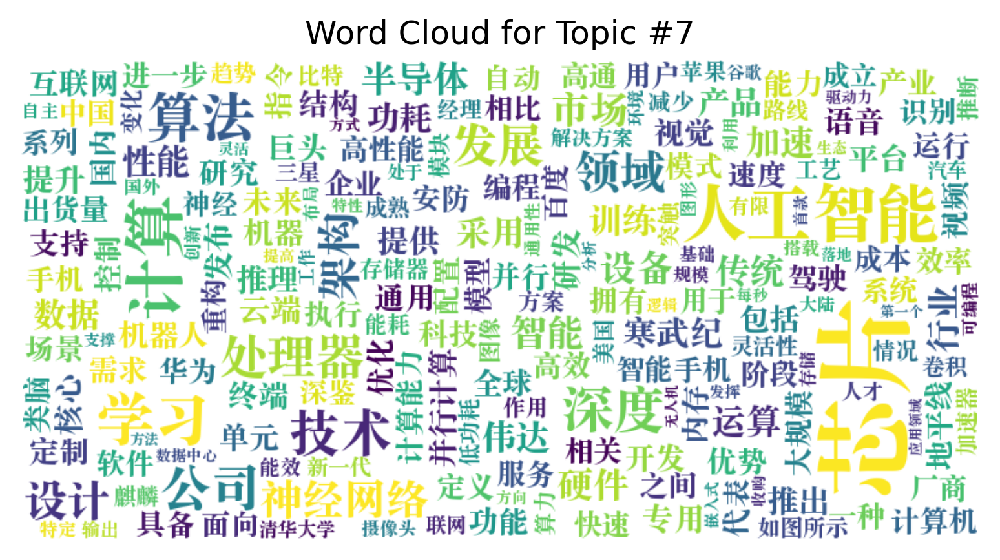

In [26]:
DrawWordCloud(lda_lx,feature_names_lx)

In [27]:
import seaborn as sns
from matplotlib import font_manager
import matplotlib as mpl
import numpy as np
# mpl.rcParams.update(mpl.rcParamsDefault)
# font_path = '/System/Library/Fonts/Supplemental/Songti.ttc'
# custom_font = font_manager.FontProperties(fname = font_path)
plt.rcParams['font.sans-serif']= ['Songti SC']


In [30]:
def DrawTopic_DocumentHeatmap(topic_dist):
    # 获取每篇文档的主主题
    primary_topics = np.argmax(topic_dist, axis = 1)
    # 按主主题排序文档
    sorted_indices = np.argsort(primary_topics)
    sorted_doc_topic_dist = topic_dist[sorted_indices]
    # 转换为DataFrame
    sorted_df = pd.DataFrame(sorted_doc_topic_dist, columns=[f'Topic {i}' for i in range(topic_dist.shape[1])])

    #绘制热力图
    plt.figure(figsize =(12, 8), dpi=300)
    sns.heatmap(sorted_df.T, cmap='Blues', cbar_kws={'label': 'Topic Proportion'}, xticklabels=False)
    plt.title('Topic-Document Distribution (Sorted)')
    plt.xlabel('Documents (sorted by primary topic)')
    plt.ylabel("Topics")
    plt.tight_layout()
    plt.show()

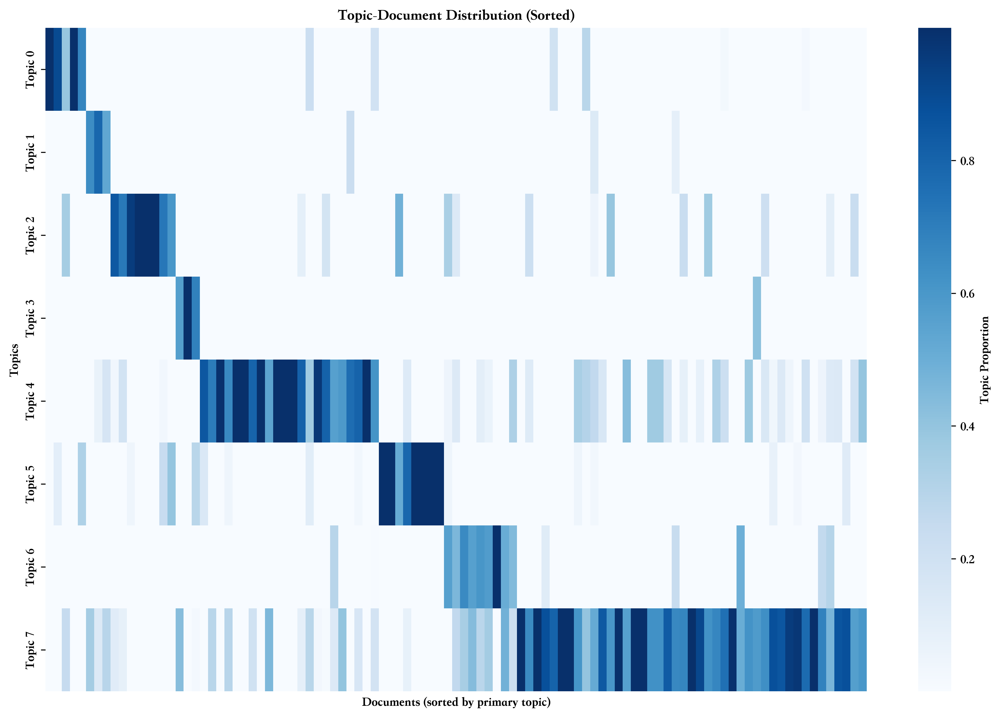

In [31]:
DrawTopic_DocumentHeatmap(topic_dist_ibm)

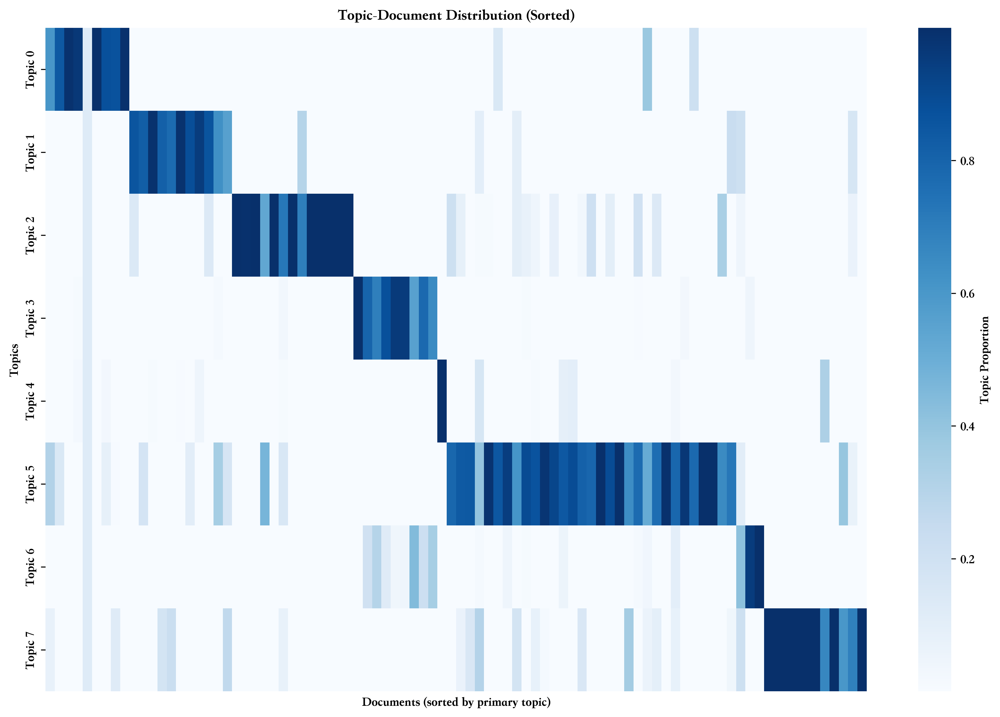

In [32]:
DrawTopic_DocumentHeatmap(topic_dist_lx)

In [56]:
import torch

In [57]:
from transformers import BertTokenizer, BertForSequenceClassification
from torch.utils.data import DataLoader

In [59]:
# 加载BERT模型和tokenizer
model = BertForSequenceClassification.from_pretrained('bert-base-chinese')
tokenizer = BertTokenizer.from_pretrained('bert-base-chinese')

Some weights of BertForSequenceClassification were not initialized from the model checkpoint at bert-base-chinese and are newly initialized: ['classifier.bias', 'classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


In [62]:
def sentiment_analysis_bert(text):
    # 对文本进行tokenization, 截断和填充
    inputs = tokenizer(text, return_tensors='pt', padding=True, truncation=True, max_length=512)
    # 模型输出
    outputs = model(**inputs)
    prediction = torch.argmax(outputs.logits, dim=-1)
    return prediction.item()

In [65]:
df_ibm['sentiment_score'] = text_ibm.apply(sentiment_analysis_bert)

In [64]:
df_lx['sentiment_score'] = text_lx.apply(sentiment_analysis_bert)